Notebook to test some ideas for plotting the waddington landscape from our sequencing data.
For now I will explore which single cell metrics from the scRNAseq work best to define the landscape topology.

<!-- Consider however, that in the future we might want to compute some kind of state centroid so that we can project some of the data from the cytof side (ie response of the different states to external cues as determined by Fig5 D) -->

<!-- **Early December update**
Make a WT and an AK landscape. 
For the slides, we would need to create static images of the 2 landscapes from 
the same angle. Additionally we would need to create an image of all INT epi on a SCENT landscape from the same angle -->


In [1]:
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import pandas as pd
import numpy as np
import graphtools
from scipy.interpolate import Rbf
from sklearn.preprocessing import MinMaxScaler

In [2]:
import plotly.io as pio

# This ensures Plotly output works in multiple places:
# plotly_mimetype: VS Code notebook UI
# notebook: "Jupyter: Export to HTML" command in VS Code
# See https://plotly.com/python/renderers/#multiple-renderers
pio.renderers.default = "plotly_mimetype+notebook"

In [3]:
#Functions

def compute_distdeg(input_df, dim_name = ["phateepi_1","phateepi_2"], split_by="curatedCLUST", 
    knn=30, distance_metric = "manhattan", scale = True, inv_degree=True,
    plot=False, rmv_outliers=True):
    #Function that computes distances and degrees of cells within a cluster
    #Results will get scaled within the cluster level so it handles them as independent entities
    output_df = pd.DataFrame(columns=dim_name+["dist","deg"])
    for i in input_df[split_by].unique():
        print(i)
        df_dist = input_df.loc[input_df[split_by]==i,dim_name]
        #Knn param is key and must be tunned according to the size of the cluster
        G = graphtools.Graph(df_dist.values, knn=knn, decay=None, distance=distance_metric)
        # Return distances by using shortest_path
        np_dist = G.shortest_path(distance="data")
        #Compute median distance to all cells for al cells -> min should be a centroid
        df_dist["dist"] = np.median(np_dist, axis=1)
        df_dist["deg"] = G.to_pygsp().d
        if rmv_outliers:
            #Replace distant outliers with median value -> DONE to smoothen landscape at the very edges of a cluster
            df_dist["dist"] = np.where(
                                df_dist["dist"]>np.percentile(df_dist["dist"],99), 
                                df_dist["dist"].median(), 
                                df_dist["dist"])
        if scale:
            df_dist["dist_scaled"] = MinMaxScaler().fit_transform(X = df_dist[["dist"]])
            df_dist["inv_deg_scaled"] = MinMaxScaler().fit_transform(X = 1/df_dist[["deg"]])
        if plot:
            #Plot cluster cells on phate and colour by distance from centroid
            plt.scatter(df_dist[dim_name[0]],df_dist[dim_name[1]],c=df_dist["dist"])
            plt.show()
            plt.scatter(df_dist[dim_name[0]],df_dist[dim_name[1]],c=df_dist["deg"])
            plt.show()

        output_df = pd.concat([output_df, df_dist])

    return output_df


# Load and process data

Compute centroids of the clusters and compute a distance for all belonging cells.

In [10]:
cell_data = pd.read_csv("input/pdo21_vrdata.csv")

In [11]:
dim_name = ["phate1","phate2"]

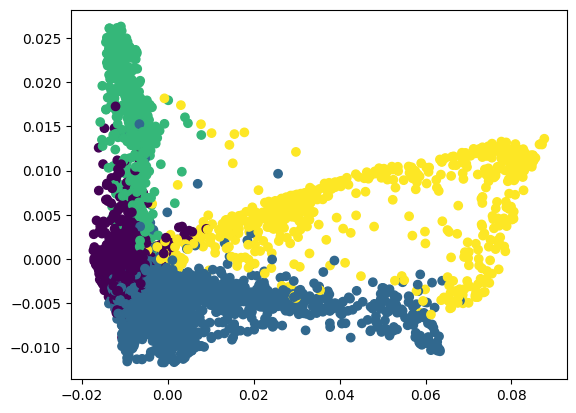

In [13]:
plt.scatter(cell_data[dim_name[0]],cell_data[dim_name[1]],c=cell_data["leidenr0.2"])

In [9]:
#This grid sets both range of phate dims and the number of "ticks" -> controls "resolution"
grid_x, grid_y = np.mgrid[-0.02:0.08:0.0024, -0.02:0.04:0.0024]

In [15]:
empty_df = compute_distdeg(cell_data, knn=50, plot=False, dim_name = dim_name, split_by="leidenr0.2")

2
1
0
3


In [16]:
#Add distances and degrees to main dataframe
cell_data = pd.merge(cell_data, empty_df.sort_index(), how="left",on=dim_name)
del empty_df

cell_data

,Unnamed: 0,leidenr0.2,phase,condition,coculture_likelihood,perturbed,proCSCsign_sig,revCSCsign_sig,CCAT,velocity_length,phate1,phate2,ENSG00000148773.14,scal_MKI67,dist,deg,dist_scaled,inv_deg_scaled
0,exp013_p21_s4:AAACATCGAAACATCGCGCGACTAx,2,G1,Coculture,0.689353,2,-0.036586,0.169742,-0.011965,0.02,-0.009364,0.020779,-0.561614,0.000000,0.004422,68,0.013307,0.427497
1,exp013_p21_s4:AAACATCGAAACATCGTGGTATACx,1,G1,PDO,0.318533,0,-0.241444,-0.049907,-0.016214,0.00,-0.000995,-0.002204,-0.561614,0.000000,0.004804,61,0.016480,0.528821
2,exp013_p21_s4:AAACATCGAACAACCATTCCGATCx,1,S,Coculture,0.396404,0,0.527593,-0.140008,0.007678,0.02,-0.003648,-0.004041,1.461487,0.399107,0.004029,52,0.002378,0.899504
3,exp013_p21_s4:AAACATCGAACCGAGAACGCCGGCx,1,G2M,PDO,0.281769,0,0.670344,-0.096378,0.036876,0.03,-0.000722,-0.008560,1.902709,0.486149,0.006268,63,0.043113,0.460829
4,exp013_p21_s4:AAACATCGAACCGAGACTATTTCAx,1,S,Coculture,0.423957,1,-0.079272,-0.110084,0.012325,0.04,-0.007214,-0.005333,-0.561614,0.000000,0.006056,57,0.039259,0.679117
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13096,exp013_p21_s5:TTCACGCATGAAGAGAAATTTCTCx,1,S,Coculture,0.417381,1,0.526005,0.103008,0.031045,0.05,-0.003856,-0.005795,1.923392,0.490229,0.004404,54,0.009203,0.806452
13097,exp013_p21_s5:TTCACGCATGAAGAGAGCTCGCGGx,3,G1,Coculture,0.438816,1,0.266362,-0.155535,0.012221,0.04,0.024969,0.003879,-0.561614,0.000000,0.018727,64,0.011214,0.493421
13098,exp013_p21_s5:TTCACGCATGGTGGTATTGTCTTAx,3,G1,PDO,0.190841,0,0.304938,-0.049237,-0.050959,0.01,0.076148,0.009396,-0.561614,0.000000,0.043025,68,0.733301,0.386997
13099,exp013_p21_s5:TTCACGCATTCACGCAGTTACGTAx,2,G1,Coculture,0.648745,2,-0.208522,0.004405,-0.010384,0.02,-0.007020,0.013594,-0.561614,0.000000,0.006579,57,0.173368,0.734394


In [21]:
print(cell_data["velocity_length"].describe())

from sklearn.preprocessing import minmax_scale
cell_data["scal_velo"] = minmax_scale(cell_data["velocity_length"],feature_range=(0.001,1))

print(cell_data["scal_velo"].describe())

count    12811.000000
mean         0.041058
std          0.030566
min          0.000000
25%          0.020000
50%          0.030000
75%          0.050000
max          0.260000
Name: velocity_length, dtype: float64
count    12811.000000
mean         0.158756
std          0.117444
min          0.001000
25%          0.077846
50%          0.116269
75%          0.193115
max          1.000000
Name: scal_velo, dtype: float64


In [23]:
# #Scale velocity length for all cells
cell_data["scal_inv_velo"] = MinMaxScaler().fit_transform(X = 1/cell_data[["scal_velo"]])

#Scale CCAT values to 0,1

cell_data["scal_CCAT"] = MinMaxScaler().fit_transform(X = cell_data[["CCAT"]])

In [24]:
cell_data["perturbed"].unique()

array([2, 0, 1])

In [25]:
# colours = {
#     "TA 1":"#FF99CC",
#     "Goblet / DCS":"#CC9900",
#     "Late Enterocyte":"#006600",
#     "proCSC":"#000099",
#     "Early Enterocyte":"#00FF99",
#     "revCSC":"#CC0000",
#     "ER Stress":"#CC00FF",
#     "CSC":"#6666FF",
#     "TA 2":"#FF6666"
#     }
col_phase = {
    "G1":"green",
    "G2M":"purple",
    "S":"pink"
}
col_cond = {
    "Coculture":"red",
    "PDO":"green"
}
# col_clust = {
#     0:"green",
#     1:"orange",
#     2:"purple",
#     3:"yellow",
#     4:"blue",
#     5:"brown",
# }
col_perturb = {
    0:"green",
    1:"grey",
    2:"pink"
}

In [28]:
fig = go.Figure(data=[go.Scatter3d(
        x=cell_data["phate1"], 
        y=cell_data["phate2"], 
        z=cell_data["CCAT"],
        mode="markers", marker=dict(
            color=cell_data["phase"].map(col_phase)
                                    ))])
fig.update_traces(marker_size = 2)
fig.update_layout(
    title="Phase",
    autosize=True,
    scene_aspectmode="cube",
    width=1000, height=1000,
    margin=dict(l=50, r=50, b=50, t=90))
fig.show()
fig.write_html(f"output/plot_pdo21_ccat_phase.html")
fig = go.Figure(data=[go.Scatter3d(
        x=cell_data["phate1"], 
        y=cell_data["phate2"], 
        z=cell_data["CCAT"],
        mode="markers", marker=dict(
            color=cell_data["scal_MKI67"]
                                    ))])
fig.update_traces(marker_size = 2)
fig.update_layout(
    title="scal_MKI67",
    autosize=True,
    scene_aspectmode="cube",
    width=1000, height=1000,
    margin=dict(l=50, r=50, b=50, t=90))
fig.show()
fig.write_html(f"output/plot_pdo21_ccat_mki67.html")
fig = go.Figure(data=[go.Scatter3d(
        x=cell_data["phate1"], 
        y=cell_data["phate2"], 
        z=cell_data["CCAT"],
        mode="markers", marker=dict(
            color=cell_data["condition"].map(col_cond)
                                    ))])
fig.update_traces(marker_size = 2)
fig.update_layout(
    title="Condition",
    autosize=True,
    scene_aspectmode="cube",
    width=1000, height=1000,
    margin=dict(l=50, r=50, b=50, t=90))
fig.show()
fig.write_html(f"output/plot_pdo21_ccat_cond.html")
fig = go.Figure(data=[go.Scatter3d(
        x=cell_data["phate1"], 
        y=cell_data["phate2"], 
        z=cell_data["CCAT"],
        mode="markers", marker=dict(
            color=cell_data["leidenr0.2"].map(col_clust)
                                    ))])
fig.update_traces(marker_size = 2)
fig.update_layout(
    title="Leiden",
    autosize=True,
    scene_aspectmode="cube",
    width=1000, height=1000,
    margin=dict(l=50, r=50, b=50, t=90))
fig.show()
fig.write_html(f"output/plot_pdo21_ccat_clust.html")
fig = go.Figure(data=[go.Scatter3d(
        x=cell_data["phate1"], 
        y=cell_data["phate2"], 
        z=cell_data["CCAT"],
        mode="markers", marker=dict(
            color=cell_data["perturbed"].map(col_perturb)
                                    ))])
fig.update_traces(marker_size = 2)
fig.update_layout(
    title="MELD",
    autosize=True,
    scene_aspectmode="cube",
    width=1000, height=1000,
    margin=dict(l=50, r=50, b=50, t=90))
fig.show()
fig.write_html(f"output/plot_pdo21_ccat_perturb.html")

# All cells

In [29]:
cell_data["CCATmed"] = cell_data.groupby(by="leidenr0.2")[["scal_CCAT"]].transform("median")

In [36]:
cell_data["invVELOmed"] = cell_data.groupby(by="leidenr0.2")[["scal_inv_velo"]].transform("median")

In [33]:
df_2 = cell_data.copy()
df_2["VR"] = df_2.apply(
    lambda x: 1*x["CCATmed"], 
    axis=1)

rbfi = Rbf(df_2[dim_name[0]], df_2[dim_name[1]], 
            df_2["VR"], 
            smooth=1, kernel = "thin_plate_spline")
di = rbfi(grid_x, grid_y)

# Change all values on interpolated grid that go above the max height in data
di[di>(round(df_2["VR"].max(),2)+0.02)] = None



fig = go.Figure(data=[go.Surface(x=grid_x,y=grid_y,z=di)])
fig.update_traces(colorscale=[[0,"blue"],[0.25,"green"],[0.5,"yellow"],[0.75,"#5f3316"],[0.85,"#513b1b"],[1,"white"]],cmax=0.36, cmin=0.2)
fig.add_scatter3d(
    x=df_2.dropna()[dim_name[0]],
    y=df_2.dropna()[dim_name[1]], 
    z=((0.1*df_2.dropna()["scal_CCAT"]+0.9*df_2.dropna()["VR"])+0.012),
    mode="markers",
    marker=dict(
        size=4, 
        color=df_2.dropna()["phase"].map(col_phase),
        opacity=0.42,
        # line=dict(width=2,
        #     color="darkgrey")
        )
    )
fig.update_layout(
    title=None,
    template = "simple_white",
    scene = dict(
        xaxis = dict(nticks=5,title=""),
        yaxis = dict(nticks=5, title = ""),
        zaxis = dict(nticks=5, range=[0.15,0.45], title="")
        ),
    autosize=True,
    width=1000, height=1000,
    margin=dict(l=0, r=0, b=0, t=0),
    scene_aspectmode="cube",
    scene_camera=dict(
        up=dict(x=0, y=0, z=1),
        center=dict(x=0, y=0, z=0),
        eye=dict(x=1.5, y=1, z=2)
    )
    )
fig.show()
fig.write_html(f"output/plot_pdo21_all_phase.html")

In [38]:
df_2 = cell_data.copy()
df_2["VR"] = df_2.apply(
    lambda x: 1*x["CCATmed"], 
    axis=1)

rbfi = Rbf(df_2[dim_name[0]], df_2[dim_name[1]], 
            df_2["VR"], 
            smooth=1, kernel = "thin_plate_spline")
di = rbfi(grid_x, grid_y)

# Change all values on interpolated grid that go above the max height in data
di[di>(round(df_2["VR"].max(),2)+0.02)] = None



fig = go.Figure(data=[go.Surface(x=grid_x,y=grid_y,z=di)])
fig.update_traces(colorscale=[[0,"blue"],[0.25,"green"],[0.5,"yellow"],[0.75,"#5f3316"],[0.85,"#513b1b"],[1,"white"]],cmax=0.36, cmin=0.2)
fig.add_scatter3d(
    x=df_2.dropna()[dim_name[0]],
    y=df_2.dropna()[dim_name[1]], 
    z=((0.1*df_2.dropna()["scal_CCAT"]+0.9*df_2.dropna()["VR"])+0.012),
    mode="markers",
    marker=dict(
        size=4, 
        color=df_2.dropna()["scal_MKI67"],
        opacity=0.42,
        # line=dict(width=2,
        #     color="darkgrey")
        )
    )
fig.update_layout(
    title=None,
    template = "simple_white",
    scene = dict(
        xaxis = dict(nticks=5,title=""),
        yaxis = dict(nticks=5, title = ""),
        zaxis = dict(nticks=5, range=[0.15,0.45], title="")
        ),
    autosize=True,
    width=1000, height=1000,
    margin=dict(l=0, r=0, b=0, t=0),
    scene_aspectmode="cube",
    scene_camera=dict(
        up=dict(x=0, y=0, z=1),
        center=dict(x=0, y=0, z=0),
        eye=dict(x=1.5, y=1, z=2)
    )
    )
fig.show()
fig.write_html(f"output/plot_pdo21_all_mki67.html")

In [37]:
df_2 = cell_data.copy()
df_2["VR"] = df_2.apply(
    lambda x: 0.9*x["CCATmed"]+0.1*(x["invVELOmed"]*x["dist_scaled"]),
    axis=1)

rbfi = Rbf(df_2[dim_name[0]], df_2[dim_name[1]], 
            df_2["VR"], 
            smooth=1, kernel = "thin_plate_spline")
di = rbfi(grid_x, grid_y)

# Change all values on interpolated grid that go above the max height in data
di[di>(round(df_2["VR"].max(),2)+0.02)] = None



fig = go.Figure(data=[go.Surface(x=grid_x,y=grid_y,z=di)])
fig.update_traces(colorscale=[[0,"blue"],[0.25,"green"],[0.5,"yellow"],[0.75,"#5f3316"],[0.85,"#513b1b"],[1,"white"]],cmax=0.36, cmin=0.2)
fig.add_scatter3d(
    x=df_2.dropna()[dim_name[0]],
    y=df_2.dropna()[dim_name[1]], 
    z=((0.1*df_2.dropna()["scal_CCAT"]+0.9*df_2.dropna()["VR"])+0.012),
    mode="markers",
    marker=dict(
        size=4, 
        color=df_2.dropna()["scal_MKI67"],
        opacity=0.42,
        # line=dict(width=2,
        #     color="darkgrey")
        )
    )
fig.update_layout(
    title=None,
    template = "simple_white",
    scene = dict(
        xaxis = dict(nticks=5,title=""),
        yaxis = dict(nticks=5, title = ""),
        zaxis = dict(nticks=5, range=[0.15,0.45], title="")
        ),
    autosize=True,
    width=1000, height=1000,
    margin=dict(l=0, r=0, b=0, t=0),
    scene_aspectmode="cube",
    scene_camera=dict(
        up=dict(x=0, y=0, z=1),
        center=dict(x=0, y=0, z=0),
        eye=dict(x=1.5, y=1, z=2)
    )
    )
fig.show()
fig.write_html(f"output/plot_pdo21_all_mki67_VELO.html")

# By condition landscapes

Monoculture

In [39]:
mono_data = cell_data.loc[(cell_data["condition"]=="PDO")]
mono_data

,Unnamed: 0,leidenr0.2,phase,condition,coculture_likelihood,perturbed,proCSCsign_sig,revCSCsign_sig,CCAT,velocity_length,...,deg,dist_scaled,inv_deg_scaled,scal_velo,inv_velo_scaled,scalCCAT,scal_inv_velo,scal_CCAT,CCATmed,invVELOmed
1,exp013_p21_s4:AAACATCGAAACATCGTGGTATACx,1,G1,PDO,0.318533,0,-0.241444,-0.049907,-0.016214,0.00,...,61,0.016480,0.528821,0.001000,1.000000,0.256077,1.000000,0.256077,0.338480,0.007608
3,exp013_p21_s4:AAACATCGAACCGAGAACGCCGGCx,1,G2M,PDO,0.281769,0,0.670344,-0.096378,0.036876,0.03,...,63,0.043113,0.460829,0.116269,0.007608,0.466970,0.007608,0.466970,0.338480,0.007608
6,exp013_p21_s4:AAACATCGAACGCTTAACTCGTAAx,0,G1,PDO,0.493890,1,0.064644,-0.110089,-0.025863,0.08,...,55,0.627027,0.792541,0.308385,0.002245,0.217746,0.002245,0.217746,0.280519,0.007608
12,exp013_p21_s4:AAACATCGAATGTTGCACTCGTAAx,1,S,PDO,0.351844,0,-0.059694,0.120493,-0.013869,0.04,...,52,0.008284,0.899504,0.154692,0.005470,0.265393,0.005470,0.265393,0.338480,0.007608
17,exp013_p21_s4:AAACATCGACCTCCAAACTCGTAAx,2,G1,PDO,0.455533,1,0.025619,0.379637,0.038309,0.02,...,50,0.979018,1.000000,0.077846,0.011858,0.472664,0.011858,0.472664,0.302307,0.005470
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13090,exp013_p21_s5:TTCACGCAGTGTTCTATTGTCTTAx,1,G2M,PDO,0.271730,0,0.395458,-0.235937,0.027556,0.03,...,63,0.041222,0.460829,0.116269,0.007608,0.429948,0.007608,0.429948,0.338480,0.007608
13094,exp013_p21_s5:TTCACGCATCTTCACAACTCGTAAx,1,G2M,PDO,0.445749,1,0.583748,0.244012,0.086356,0.03,...,56,0.045018,0.720046,0.116269,0.007608,0.663528,0.007608,0.663528,0.338480,0.007608
13095,exp013_p21_s5:TTCACGCATCTTCACAAGCGAAACx,1,G1,PDO,0.470299,1,-0.212036,0.030302,0.020621,0.01,...,66,0.036017,0.366569,0.039423,0.024390,0.402400,0.024390,0.402400,0.338480,0.007608
13098,exp013_p21_s5:TTCACGCATGGTGGTATTGTCTTAx,3,G1,PDO,0.190841,0,0.304938,-0.049237,-0.050959,0.01,...,68,0.733301,0.386997,0.039423,0.024390,0.118056,0.024390,0.118056,0.188044,0.007608


Coculture

In [40]:
cocult_data = cell_data.loc[(cell_data["condition"]=="Coculture")]
cocult_data

,Unnamed: 0,leidenr0.2,phase,condition,coculture_likelihood,perturbed,proCSCsign_sig,revCSCsign_sig,CCAT,velocity_length,...,deg,dist_scaled,inv_deg_scaled,scal_velo,inv_velo_scaled,scalCCAT,scal_inv_velo,scal_CCAT,CCATmed,invVELOmed
0,exp013_p21_s4:AAACATCGAAACATCGCGCGACTAx,2,G1,Coculture,0.689353,2,-0.036586,0.169742,-0.011965,0.02,...,68,0.013307,0.427497,0.077846,0.011858,0.272955,0.011858,0.272955,0.302307,0.005470
2,exp013_p21_s4:AAACATCGAACAACCATTCCGATCx,1,S,Coculture,0.396404,0,0.527593,-0.140008,0.007678,0.02,...,52,0.002378,0.899504,0.077846,0.011858,0.350987,0.011858,0.350987,0.338480,0.007608
4,exp013_p21_s4:AAACATCGAACCGAGACTATTTCAx,1,S,Coculture,0.423957,1,-0.079272,-0.110084,0.012325,0.04,...,57,0.039259,0.679117,0.154692,0.005470,0.369445,0.005470,0.369445,0.338480,0.007608
5,exp013_p21_s4:AAACATCGAACCGAGAGGTGGAGCx,0,G1,Coculture,0.520676,1,-0.153682,-0.109114,-0.041151,0.00,...,65,0.535297,0.473373,0.001000,1.000000,0.157015,1.000000,0.157015,0.280519,0.007608
7,exp013_p21_s4:AAACATCGAAGAGATCTTCCGATCx,0,G1,Coculture,0.698308,2,-0.203702,0.107128,-0.055847,0.01,...,63,0.040611,0.529101,0.039423,0.024390,0.098639,0.024390,0.098639,0.280519,0.007608
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13092,exp013_p21_s5:TTCACGCATATCAGCAGGGATCGGx,0,G1,Coculture,0.576680,1,0.007457,-0.040872,-0.048758,0.03,...,56,0.215538,0.755495,0.116269,0.007608,0.126797,0.007608,0.126797,0.280519,0.007608
13093,exp013_p21_s5:TTCACGCATCCGTCTATAAATATCx,0,G1,Coculture,0.649025,2,0.280585,-0.093302,0.013959,0.04,...,56,0.000540,0.755495,0.154692,0.005470,0.375937,0.005470,0.375937,0.280519,0.007608
13096,exp013_p21_s5:TTCACGCATGAAGAGAAATTTCTCx,1,S,Coculture,0.417381,1,0.526005,0.103008,0.031045,0.05,...,54,0.009203,0.806452,0.193115,0.004182,0.443811,0.004182,0.443811,0.338480,0.007608
13097,exp013_p21_s5:TTCACGCATGAAGAGAGCTCGCGGx,3,G1,Coculture,0.438816,1,0.266362,-0.155535,0.012221,0.04,...,64,0.011214,0.493421,0.154692,0.005470,0.369031,0.005470,0.369031,0.188044,0.007608


Group landscapes together in a dict

In [42]:
df_dict = {"Mono":mono_data, "Cocult":cocult_data}

for key, df in df_dict.items():
    df["CCATmed"] = df.groupby(by="leidenr0.2")[["scal_CCAT"]].transform("median")


/tmp/ipykernel_178211/832695543.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_178211/832695543.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Compute VR score, interpolate to a landscape, and plot results.

In [53]:
for key,df in df_dict.items():
    df_2 = df.copy()
    df_2["VR"] = df_2.apply(
        lambda x: 0.9*x["CCATmed"]+0.1*(x["invVELOmed"]*x["dist_scaled"]),
        axis=1)

    rbfi = Rbf(df_2[dim_name[0]], df_2[dim_name[1]], 
                df_2["VR"], 
                smooth=1, kernel = "thin_plate_spline")
    di = rbfi(grid_x, grid_y)

    # Change all values on interpolated grid that go above the max height in data
    di[di>(round(df_2["VR"].max(),2)+0.024)] = None



    fig = go.Figure(data=[go.Surface(x=grid_x,y=grid_y,z=di)])
    fig.update_traces(colorscale=[[0,"blue"],[0.25,"green"],[0.5,"yellow"],[0.75,"#5f3316"],[0.85,"#513b1b"],[1,"white"]],cmax=0.36, cmin=0.15)
    fig.add_scatter3d(
        x=df_2.dropna()[dim_name[0]],
        y=df_2.dropna()[dim_name[1]], 
        z=((0.1*df_2.dropna()["scal_CCAT"]+0.9*df_2.dropna()["VR"])+0.012),
        mode="markers",
        marker=dict(
            size=4, 
            color=df_2.dropna()["scal_MKI67"],
            opacity=0.42,
            # line=dict(width=2,
            #     color="darkgrey")
            )
        )
    fig.update_layout(
        title=None,
        template = "simple_white",
        scene = dict(
            xaxis = dict(nticks=5,title=""),
            yaxis = dict(nticks=5, title = ""),
            zaxis = dict(nticks=5, range=[0.12,0.48], title="")
            ),
        autosize=True,
        width=1000, height=1000,
        margin=dict(l=0, r=0, b=0, t=0),
        scene_aspectmode="cube",
        scene_camera=dict(
            up=dict(x=0, y=0, z=1),
            center=dict(x=0, y=0, z=0),
            eye=dict(x=1.5, y=1, z=2)
        )
        )
    fig.show()
    fig.write_html(f"output/plot_pdo21_{key}_mki67_VELO.html")

# By pertubation MELD bin

In [25]:
meld0 = cell_data.loc[(cell_data["perturbed"]==0)]
meld1 = cell_data.loc[(cell_data["perturbed"]==1)]
meld2 = cell_data.loc[(cell_data["perturbed"]==2)]

In [26]:
df_dict = {"meld_mono":meld0, "meld_mix":meld1,"meld_cocult":meld2}

for key, df in df_dict.items():
    df["CCATmed"] = df.groupby(by="leidenr0.5")[["scalCCAT"]].transform("median")

/tmp/ipykernel_178560/3627375555.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_178560/3627375555.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_178560/3627375555.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [27]:
for key,df in df_dict.items():
    df_2 = df.copy()
    df_2["VR"] = df_2.apply(
        lambda x: 1*x["CCATmed"], 
        axis=1)

    rbfi = Rbf(df_2[dim_name[0]], df_2[dim_name[1]], 
                df_2["VR"], 
                smooth=1, kernel = "thin_plate_spline")
    di = rbfi(grid_x, grid_y)
    
    # Change all values on interpolated grid that go above the max height in data
    di[di>(round(df_2["VR"].max(),2)+0.02)] = None



    fig = go.Figure(data=[go.Surface(x=grid_x,y=grid_y,z=di)])
    fig.update_traces(colorscale=[[0,"blue"],[0.25,"green"],[0.5,"yellow"],[0.75,"#5f3316"],[0.85,"#513b1b"],[1,"white"]],cmax=0.36, cmin=0.2)
    fig.add_scatter3d(
        x=df_2.dropna()[dim_name[0]],
        y=df_2.dropna()[dim_name[1]], 
        z=((0.1*df_2.dropna()["scalCCAT"]+0.9*df_2.dropna()["VR"])+0.012),
        mode="markers",
        marker=dict(
            size=4, 
            color=df_2.dropna()["phase"].map(col_phase),
            opacity=0.42,
            # line=dict(width=2,
            #     color="darkgrey")
            )
        )
    fig.update_layout(
        title=None,
        template = "simple_white",
        scene = dict(
            xaxis = dict(nticks=5,title=""),
            yaxis = dict(nticks=5, title = ""),
            zaxis = dict(nticks=5, range=[0.2,0.45], title="")
            ),
        autosize=True,
        width=1000, height=1000,
        margin=dict(l=0, r=0, b=0, t=0),
        scene_aspectmode="cube",
        scene_camera=dict(
            up=dict(x=0, y=0, z=1),
            center=dict(x=0, y=0, z=0),
            eye=dict(x=1.5, y=1, z=2)
        )
        )
    fig.show()
    fig.write_html(f"output/plot_pdo21_{key}_phase.html")

In [28]:
for key,df in df_dict.items():
    df_2 = df.copy()
    df_2["VR"] = df_2.apply(
        lambda x: 1*x["CCATmed"], 
        axis=1)

    rbfi = Rbf(df_2[dim_name[0]], df_2[dim_name[1]], 
                df_2["VR"], 
                smooth=1, kernel = "thin_plate_spline")
    di = rbfi(grid_x, grid_y)
    
    # Change all values on interpolated grid that go above the max height in data
    di[di>(round(df_2["VR"].max(),2)+0.02)] = None



    fig = go.Figure(data=[go.Surface(x=grid_x,y=grid_y,z=di)])
    fig.update_traces(colorscale=[[0,"blue"],[0.25,"green"],[0.5,"yellow"],[0.75,"#5f3316"],[0.85,"#513b1b"],[1,"white"]],cmax=0.36, cmin=0.2)
    fig.add_scatter3d(
        x=df_2.dropna()[dim_name[0]],
        y=df_2.dropna()[dim_name[1]], 
        z=((0.1*df_2.dropna()["scalCCAT"]+0.9*df_2.dropna()["VR"])+0.012),
        mode="markers",
        marker=dict(
            size=4, 
            color=df_2.dropna()["leidenr0.5"].map(col_clust),
            opacity=0.42,
            # line=dict(width=2,
            #     color="darkgrey")
            )
        )
    fig.update_layout(
        title=None,
        template = "simple_white",
        scene = dict(
            xaxis = dict(nticks=5,title=""),
            yaxis = dict(nticks=5, title = ""),
            zaxis = dict(nticks=5, range=[0.2,0.45], title="")
            ),
        autosize=True,
        width=1000, height=1000,
        margin=dict(l=0, r=0, b=0, t=0),
        scene_aspectmode="cube",
        scene_camera=dict(
            up=dict(x=0, y=0, z=1),
            center=dict(x=0, y=0, z=0),
            eye=dict(x=1.5, y=1, z=2)
        )
        )
    fig.show()
    fig.write_html(f"output/plot_pdo21_{key}_clust.html")

In [29]:
for key,df in df_dict.items():
    df_2 = df.copy()
    df_2["VR"] = df_2.apply(
        lambda x: 1*x["CCATmed"], 
        axis=1)

    rbfi = Rbf(df_2[dim_name[0]], df_2[dim_name[1]], 
                df_2["VR"], 
                smooth=1, kernel = "thin_plate_spline")
    di = rbfi(grid_x, grid_y)
    
    # Change all values on interpolated grid that go above the max height in data
    di[di>(round(df_2["VR"].max(),2)+0.02)] = None



    fig = go.Figure(data=[go.Surface(x=grid_x,y=grid_y,z=di)])
    fig.update_traces(colorscale=[[0,"blue"],[0.25,"green"],[0.5,"yellow"],[0.75,"#5f3316"],[0.85,"#513b1b"],[1,"white"]],cmax=0.36, cmin=0.2)
    fig.add_scatter3d(
        x=df_2.dropna()[dim_name[0]],
        y=df_2.dropna()[dim_name[1]], 
        z=((0.1*df_2.dropna()["scalCCAT"]+0.9*df_2.dropna()["VR"])+0.012),
        mode="markers",
        marker=dict(
            size=4, 
            color=df_2.dropna()["condition"].map(col_cond),
            opacity=0.42,
            # line=dict(width=2,
            #     color="darkgrey")
            )
        )
    fig.update_layout(
        title=None,
        template = "simple_white",
        scene = dict(
            xaxis = dict(nticks=5,title=""),
            yaxis = dict(nticks=5, title = ""),
            zaxis = dict(nticks=5, range=[0.2,0.45], title="")
            ),
        autosize=True,
        width=1000, height=1000,
        margin=dict(l=0, r=0, b=0, t=0),
        scene_aspectmode="cube",
        scene_camera=dict(
            up=dict(x=0, y=0, z=1),
            center=dict(x=0, y=0, z=0),
            eye=dict(x=1.5, y=1, z=2)
        )
        )
    fig.show()
    fig.write_html(f"output/plot_pdo21_{key}_cond.html")

# Generate and export landscape dataframes

In [45]:
landscape_dict = {}
for key,df in df_dict.items():
    df_landscape = df.copy()
    df_landscape["VR"] = df_landscape.apply(
        lambda x: 0.9*x["CCATmed"]+0.1*(x["invVELOmed"]*x["dist_scaled"]),
        axis=1)
    landscape_dict[key] = df_landscape

In [48]:
landscape_dict["Mono"]

,Unnamed: 0,leidenr0.2,phase,condition,coculture_likelihood,perturbed,proCSCsign_sig,revCSCsign_sig,CCAT,velocity_length,...,dist_scaled,inv_deg_scaled,scal_velo,inv_velo_scaled,scalCCAT,scal_inv_velo,scal_CCAT,CCATmed,invVELOmed,VR
1,exp013_p21_s4:AAACATCGAAACATCGTGGTATACx,1,G1,PDO,0.318533,0,-0.241444,-0.049907,-0.016214,0.00,...,0.016480,0.528821,0.001000,1.000000,0.256077,1.000000,0.256077,0.310381,0.007608,0.279355
3,exp013_p21_s4:AAACATCGAACCGAGAACGCCGGCx,1,G2M,PDO,0.281769,0,0.670344,-0.096378,0.036876,0.03,...,0.043113,0.460829,0.116269,0.007608,0.466970,0.007608,0.466970,0.310381,0.007608,0.279376
6,exp013_p21_s4:AAACATCGAACGCTTAACTCGTAAx,0,G1,PDO,0.493890,1,0.064644,-0.110089,-0.025863,0.08,...,0.627027,0.792541,0.308385,0.002245,0.217746,0.002245,0.217746,0.280078,0.007608,0.252547
12,exp013_p21_s4:AAACATCGAATGTTGCACTCGTAAx,1,S,PDO,0.351844,0,-0.059694,0.120493,-0.013869,0.04,...,0.008284,0.899504,0.154692,0.005470,0.265393,0.005470,0.265393,0.310381,0.007608,0.279349
17,exp013_p21_s4:AAACATCGACCTCCAAACTCGTAAx,2,G1,PDO,0.455533,1,0.025619,0.379637,0.038309,0.02,...,0.979018,1.000000,0.077846,0.011858,0.472664,0.011858,0.472664,0.265162,0.005470,0.239182
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13090,exp013_p21_s5:TTCACGCAGTGTTCTATTGTCTTAx,1,G2M,PDO,0.271730,0,0.395458,-0.235937,0.027556,0.03,...,0.041222,0.460829,0.116269,0.007608,0.429948,0.007608,0.429948,0.310381,0.007608,0.279374
13094,exp013_p21_s5:TTCACGCATCTTCACAACTCGTAAx,1,G2M,PDO,0.445749,1,0.583748,0.244012,0.086356,0.03,...,0.045018,0.720046,0.116269,0.007608,0.663528,0.007608,0.663528,0.310381,0.007608,0.279377
13095,exp013_p21_s5:TTCACGCATCTTCACAAGCGAAACx,1,G1,PDO,0.470299,1,-0.212036,0.030302,0.020621,0.01,...,0.036017,0.366569,0.039423,0.024390,0.402400,0.024390,0.402400,0.310381,0.007608,0.279370
13098,exp013_p21_s5:TTCACGCATGGTGGTATTGTCTTAx,3,G1,PDO,0.190841,0,0.304938,-0.049237,-0.050959,0.01,...,0.733301,0.386997,0.039423,0.024390,0.118056,0.024390,0.118056,0.166187,0.007608,0.150126


In [49]:
landscape_dict["Cocult"]

,Unnamed: 0,leidenr0.2,phase,condition,coculture_likelihood,perturbed,proCSCsign_sig,revCSCsign_sig,CCAT,velocity_length,...,dist_scaled,inv_deg_scaled,scal_velo,inv_velo_scaled,scalCCAT,scal_inv_velo,scal_CCAT,CCATmed,invVELOmed,VR
0,exp013_p21_s4:AAACATCGAAACATCGCGCGACTAx,2,G1,Coculture,0.689353,2,-0.036586,0.169742,-0.011965,0.02,...,0.013307,0.427497,0.077846,0.011858,0.272955,0.011858,0.272955,0.306695,0.005470,0.276033
2,exp013_p21_s4:AAACATCGAACAACCATTCCGATCx,1,S,Coculture,0.396404,0,0.527593,-0.140008,0.007678,0.02,...,0.002378,0.899504,0.077846,0.011858,0.350987,0.011858,0.350987,0.400556,0.007608,0.360502
4,exp013_p21_s4:AAACATCGAACCGAGACTATTTCAx,1,S,Coculture,0.423957,1,-0.079272,-0.110084,0.012325,0.04,...,0.039259,0.679117,0.154692,0.005470,0.369445,0.005470,0.369445,0.400556,0.007608,0.360530
5,exp013_p21_s4:AAACATCGAACCGAGAGGTGGAGCx,0,G1,Coculture,0.520676,1,-0.153682,-0.109114,-0.041151,0.00,...,0.535297,0.473373,0.001000,1.000000,0.157015,1.000000,0.157015,0.280526,0.007608,0.252880
7,exp013_p21_s4:AAACATCGAAGAGATCTTCCGATCx,0,G1,Coculture,0.698308,2,-0.203702,0.107128,-0.055847,0.01,...,0.040611,0.529101,0.039423,0.024390,0.098639,0.024390,0.098639,0.280526,0.007608,0.252504
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13092,exp013_p21_s5:TTCACGCATATCAGCAGGGATCGGx,0,G1,Coculture,0.576680,1,0.007457,-0.040872,-0.048758,0.03,...,0.215538,0.755495,0.116269,0.007608,0.126797,0.007608,0.126797,0.280526,0.007608,0.252637
13093,exp013_p21_s5:TTCACGCATCCGTCTATAAATATCx,0,G1,Coculture,0.649025,2,0.280585,-0.093302,0.013959,0.04,...,0.000540,0.755495,0.154692,0.005470,0.375937,0.005470,0.375937,0.280526,0.007608,0.252473
13096,exp013_p21_s5:TTCACGCATGAAGAGAAATTTCTCx,1,S,Coculture,0.417381,1,0.526005,0.103008,0.031045,0.05,...,0.009203,0.806452,0.193115,0.004182,0.443811,0.004182,0.443811,0.400556,0.007608,0.360507
13097,exp013_p21_s5:TTCACGCATGAAGAGAGCTCGCGGx,3,G1,Coculture,0.438816,1,0.266362,-0.155535,0.012221,0.04,...,0.011214,0.493421,0.154692,0.005470,0.369031,0.005470,0.369031,0.204757,0.007608,0.184290


In [50]:
df_landscape = pd.concat([landscape_dict["Mono"], landscape_dict["Cocult"]], keys=landscape_dict.keys())
df_landscape

Unnamed: 0  leidenr0.2 phase   
Mono   1      exp013_p21_s4:AAACATCGAAACATCGTGGTATACx           1    G1  \
       3      exp013_p21_s4:AAACATCGAACCGAGAACGCCGGCx           1   G2M   
       6      exp013_p21_s4:AAACATCGAACGCTTAACTCGTAAx           0    G1   
       12     exp013_p21_s4:AAACATCGAATGTTGCACTCGTAAx           1     S   
       17     exp013_p21_s4:AAACATCGACCTCCAAACTCGTAAx           2    G1   
...                                               ...         ...   ...   
Cocult 13092  exp013_p21_s5:TTCACGCATATCAGCAGGGATCGGx           0    G1   
       13093  exp013_p21_s5:TTCACGCATCCGTCTATAAATATCx           0    G1   
       13096  exp013_p21_s5:TTCACGCATGAAGAGAAATTTCTCx           1     S   
       13097  exp013_p21_s5:TTCACGCATGAAGAGAGCTCGCGGx           3    G1   
       13099  exp013_p21_s5:TTCACGCATTCACGCAGTTACGTAx           2    G1   

              condition  coculture_likelihood  perturbed  proCSCsign_sig   
Mono   1            PDO              0.318533          0       -0.241444  \
       3            PDO              0.281769          0        0.670344   
       6            PDO              0.493890          1        0.064644   
       12           PDO              0.351844          0       -0.059694   
       17           PDO              0.455533          1        0.025619   
...                 ...                   ...        ...             ...   
Cocult 13092  Coculture              0.576680          1        0.007457   
       13093  Coculture              0.649025          2        0.280585   
       13096  Coculture              0.417381          1        0.526005   
       13097  Coculture              0.438816          1        0.266362   
       13099  Coculture              0.648745          2       -0.208522   

              revCSCsign_sig      CCAT  velocity_length  ...  dist_scaled   
Mono   1           -0.049907 -0.016214             0.00  ...     0.016480  \
       3           -0.096378  0.036876             0.03  ...     0.043113   
       6           -0.110089 -0.025863             0.08  ...     0.627027   
       12           0.120493 -0.013869             0.04  ...     0.008284   
       17           0.379637  0.038309             0.02  ...     0.979018   
...                      ...       ...              ...  ...          ...   
Cocult 13092       -0.040872 -0.048758             0.03  ...     0.215538   
       13093       -0.093302  0.013959             0.04  ...     0.000540   
       13096        0.103008  0.031045             0.05  ...     0.009203   
       13097       -0.155535  0.012221             0.04  ...     0.011214   
       13099        0.004405 -0.010384             0.02  ...     0.173368   

              inv_deg_scaled  scal_velo  inv_velo_scaled  scalCCAT   
Mono   1            0.528821   0.001000         1.000000  0.256077  \
       3            0.460829   0.116269         0.007608  0.466970   
       6            0.792541   0.308385         0.002245  0.217746   
       12           0.899504   0.154692         0.005470  0.265393   
       17           1.000000   0.077846         0.011858  0.472664   
...                      ...        ...              ...       ...   
Cocult 13092        0.755495   0.116269         0.007608  0.126797   
       13093        0.755495   0.154692         0.005470  0.375937   
       13096        0.806452   0.193115         0.004182  0.443811   
       13097        0.493421   0.154692         0.005470  0.369031   
       13099        0.734394   0.077846         0.011858  0.279237   

             scal_inv_velo  scal_CCAT   CCATmed  invVELOmed        VR  
Mono   1          1.000000   0.256077  0.310381    0.007608  0.279355  
       3          0.007608   0.466970  0.310381    0.007608  0.279376  
       6          0.002245   0.217746  0.280078    0.007608  0.252547  
       12         0.005470   0.265393  0.310381    0.007608  0.279349  
       17         0.011858   0.472664  0.265162    0.005470  0.239182  
...                    ...     

In [51]:
#Save data to file:
df_landscape.reset_index().drop(["level_1"], axis=1).to_csv("output/dLANDSCAPE_pdo21.csv", index=False)